In [156]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [157]:
from koala.pointsets import uniform
from koala import graph_utils as gu
from koala import plotting as pl
from koala.voronization import generate_lattice
from koala.graph_color import color_lattice
from koala.flux_finder import fluxes_from_ujk, ujk_from_fluxes
from koala.lattice import Lattice
from scipy import linalg as la
from pfapack.pfaffian import pfaffian
from copy import copy
from koala.lattice import INVALID
from koala import example_graphs as eg
from dimer_models.koala_plantri import plantri_to_koala, plantri_generator, read_plantri
from dimer_models.lattice_generation import (
    bipartite_squarefull,
    reduce_bipartite,
)
from tqdm import tqdm

import matplotlib as mpl
from collections import Counter

from dimer_models.kasteleyn import find_kasteleyn_number

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import pickle

In [158]:
from os import listdir
from os.path import isfile, join

open_bc = False
mypath = "monomer_results/res_w_inv"
filenames = sorted([f for f in listdir(mypath) if isfile(join(mypath, f))])

filenames = [u for u in filenames if str(open_bc) in u]
filenames

['n00100_bcFalse.pkl',
 'n00200_bcFalse.pkl',
 'n00400_bcFalse.pkl',
 'n00600_bcFalse.pkl',
 'n01000_bcFalse.pkl',
 'n01400_bcFalse.pkl',
 'n02000_bcFalse.pkl',
 'n04000_bcFalse.pkl',
 'n06000_bcFalse.pkl']

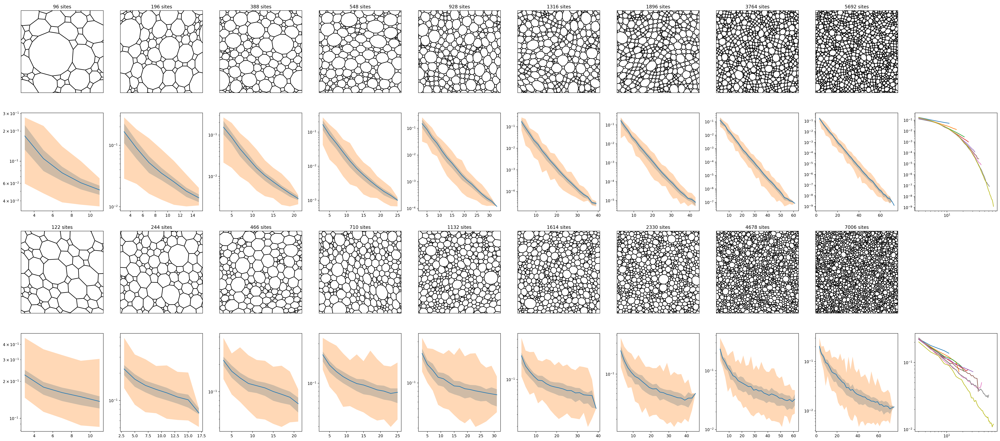

In [159]:
scale = 4
number_of_lattices = 2

fig, ax = plt.subplots(
    number_of_lattices * 2,
    len(filenames) + 1,
    figsize=(
        scale * len(filenames),
        scale * number_of_lattices * 2,
    ),
    dpi=200,
)

for col, filename in enumerate(filenames):
    with open(f"{mypath}/{filename}", "rb") as f:
        try:
            results = pickle.load(f)
        except:
            continue

    for row, res in enumerate(results):
        lattice = res["lattice"]
        distances = res["distances"]
        partition = res["partition_func"]
        mags = res["mags"]
        pows = res["powers"]

        probability = (mags / partition[0]) * 10 ** (pows - partition[1])

        dist_unique = np.unique(distances)
        mean = np.array([np.mean(probability[distances == x]) for x in dist_unique])
        upper_quart = np.array(
            [np.percentile(probability[distances == x], 25) for x in dist_unique]
        )
        lower_quart = np.array(
            [np.percentile(probability[distances == x], 75) for x in dist_unique]
        )
        upper_lim = np.array([np.max(probability[distances == x]) for x in dist_unique])
        lower_lim = np.array([np.min(probability[distances == x]) for x in dist_unique])

        plaquette_types = [p.n_sides for p in lattice.plaquettes]
        plaq_counts = Counter(plaquette_types)

        a_lattice = ax[row * 2, col]
        a_plot = ax[row * 2 + 1, col]
        a_final = ax[row * 2 + 1, -1]
        a_empty = ax[row * 2, -1]
        a_empty.set_axis_off()

        a_lattice.set_xticks([])
        a_lattice.set_yticks([])
        a_lattice.set_aspect("equal")
        a_lattice.set_title(f"{lattice.n_vertices} sites")
        pl.plot_edges(lattice, ax=a_lattice)

        a_plot.set_aspect("auto")
        a_plot.plot(dist_unique, mean)
        a_plot.fill_between(dist_unique, lower_quart, upper_quart, alpha=0.3)
        a_plot.fill_between(dist_unique, lower_lim, upper_lim, alpha=0.3)

        # a_plot.set_ylim(0, np.max(upper_lim))
        a_final.plot(dist_unique, mean)

        a_plot.set_yscale("log")
        # a_plot.set_xscale("log")
        a_final.set_yscale("log")
        a_final.set_xscale("log")

plt.tight_layout()
plt.savefig("monomer_probabilities.pdf")
plt.show()

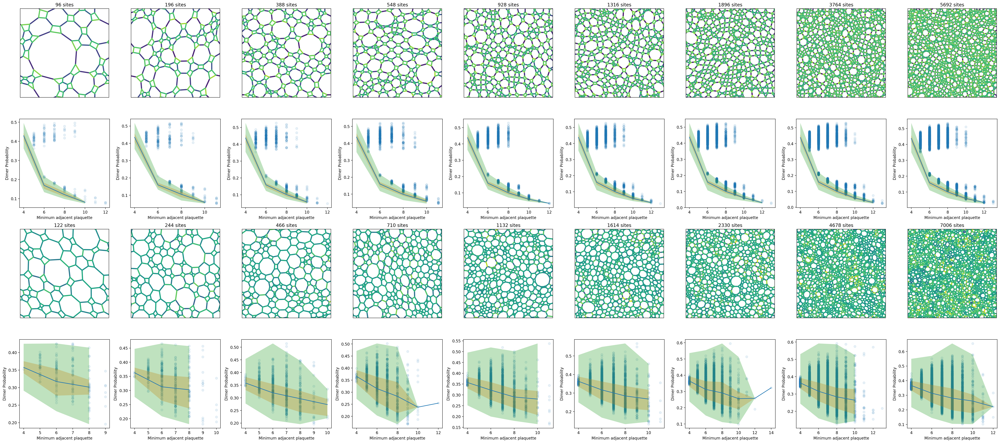

In [160]:
from matplotlib import colormaps

fig, ax = plt.subplots(
    number_of_lattices * 2,
    len(filenames),
    figsize=(
        scale * len(filenames),
        scale * number_of_lattices * 2,
    ),
    dpi=200,
)

for col, filename in enumerate(filenames):
    with open(f"{mypath}/{filename}", "rb") as f:
        try:
            results = pickle.load(f)
        except:
            continue

    for row, res in enumerate(results):
        lattice = res["lattice"]
        dimer_probs = res["dimer_probs"]

        plaquette_n_sides = np.array([p.n_sides for p in lattice.plaquettes])

        neighbour_sides = plaquette_n_sides[lattice.edges.adjacent_plaquettes]
        avg_neighbours = np.mean(neighbour_sides, axis=1)
        min_neighbours = np.min(neighbour_sides, axis=1)
        neigh_unique = np.unique(min_neighbours)

        mean = np.array(
            [np.mean(dimer_probs[min_neighbours == x]) for x in neigh_unique]
        )
        upper_quart = np.array(
            [np.percentile(dimer_probs[min_neighbours == x], 25) for x in neigh_unique]
        )
        lower_quart = np.array(
            [np.percentile(dimer_probs[min_neighbours == x], 75) for x in neigh_unique]
        )
        upper_lim = np.array(
            [np.max(dimer_probs[min_neighbours == x]) for x in neigh_unique]
        )
        lower_lim = np.array(
            [np.min(dimer_probs[min_neighbours == x]) for x in neigh_unique]
        )

        a_lattice = ax[row * 2, col]
        a_plot = ax[row * 2 + 1, col]

        a_plot.plot(neigh_unique, mean)
        a_plot.scatter(avg_neighbours, dimer_probs, alpha=0.1)
        a_plot.fill_between(neigh_unique, lower_quart, upper_quart, alpha=0.3)
        a_plot.fill_between(neigh_unique, lower_lim, upper_lim, alpha=0.3)
        a_plot.set_xlabel("Minimum adjacent plaquette")
        a_plot.set_ylabel("Dimer Probability")

        edge_labels = np.arange(lattice.n_edges)
        cmap = plt.get_cmap("viridis")
        color_scheme = cmap(np.abs(dimer_probs) / 0.6)

        pl.plot_edges(
            lattice,
            ax=a_lattice,
            labels=edge_labels,
            color_scheme=color_scheme,
            linewidth=3,
        )

        a_lattice.set_xticks([])
        a_lattice.set_yticks([])
        a_lattice.set_aspect("equal")
        a_lattice.set_title(f"{lattice.n_vertices} sites")

plt.tight_layout()
plt.savefig("dimer_probabilities.pdf")

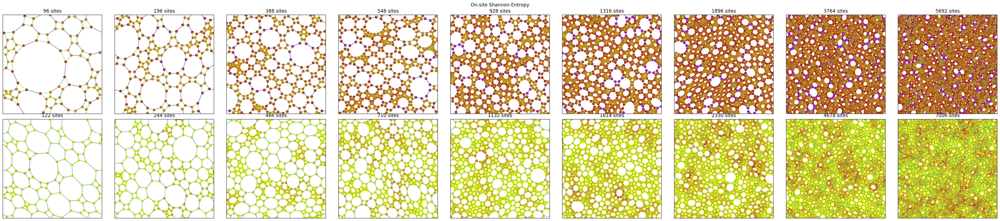

In [161]:
from scipy.stats import entropy

fig, ax = plt.subplots(
    number_of_lattices,
    len(filenames),
    figsize=(
        scale * len(filenames),
        scale * number_of_lattices,
    ),
    dpi=200,
)

for col, filename in enumerate(filenames):
    with open(f"{mypath}/{filename}", "rb") as f:
        try:
            results = pickle.load(f)
        except:
            continue

    for row, res in enumerate(results):
        lattice = res["lattice"]
        dimer_probs = res["dimer_probs"]

        site_probs = dimer_probs[lattice.vertices.adjacent_edges]
        e = entropy(site_probs, axis=1, base=3)
        e = (e - entropy((1, 1, 0), base=3)) / (1 - entropy((1, 1, 0), base=3))

        a_lattice = ax[row, col]
        # a_plot = ax[row, col]

        edge_labels = np.arange(lattice.n_edges)
        cmap = plt.get_cmap("gnuplot")

        site_colours = cmap(e)
        color_scheme = plt.get_cmap("viridis")(np.abs(dimer_probs) / 0.6)

        pl.plot_edges(
            lattice,
            ax=a_lattice,
            labels=edge_labels,
            color_scheme=color_scheme,
            linewidth=0.8,
        )

        x = a_lattice.scatter(
            lattice.vertices.positions[:, 0],
            lattice.vertices.positions[:, 1],
            color=site_colours,
        )

        a_lattice.set_xticks([])
        a_lattice.set_yticks([])
        a_lattice.set_aspect("equal")
        a_lattice.set_title(f"{lattice.n_vertices} sites")

# fig.colorbar(
#     mpl.cm.ScalarMappable(cmap=cmap),
#     cax=ax, orientation='horizontal',
#     extend='both',
#     spacing='proportional',
#     label='Discrete intervals, some other units',
# )
# x, cmap=plt.get_cmap("gnuplot"))

fig.suptitle("On-site Shannon Entropy")
plt.tight_layout()
plt.savefig("site_entropy.pdf")

In [162]:
entropy([1, 0, 0], base=3)

np.float64(0.0)